In [32]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller

In [33]:
# Load the dataset
data = pd.read_csv(r'../data/part_1/historical_weather_without_outliers.csv')

# Convert the 'date' column to datetime format and set it as the index
data['date'] = pd.to_datetime(data['date'])
data.set_index('date', inplace=True)

In [34]:
# Function to perform seasonal decomposition
def seasonal_decomposition(city_data, city_id):
    decomposition = seasonal_decompose(city_data['avg_temp_c'], model='additive', period=365)
    
    # Plot the decomposition
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(12, 10), sharex=True)
    ax1.plot(decomposition.observed, label='Original')
    ax1.set_ylabel('Original')
    ax1.legend(loc='upper left')
    ax1.set_xlabel('Date')
    
    ax2.plot(decomposition.trend, label='Trend')
    ax2.set_ylabel('Trend')
    ax2.legend(loc='upper left')
    ax2.set_xlabel('Date')
    
    ax3.plot(decomposition.seasonal, label='Seasonal')
    ax3.set_ylabel('Seasonal')
    ax3.legend(loc='upper left')
    ax3.set_xlabel('Date')
    
    ax4.plot(decomposition.resid, label='Residual')
    ax4.set_ylabel('Residual')
    ax4.legend(loc='upper left')
    ax4.set_xlabel('Date')
    
    plt.suptitle(f'Seasonal Decomposition of {city_id}')
    plt.show()

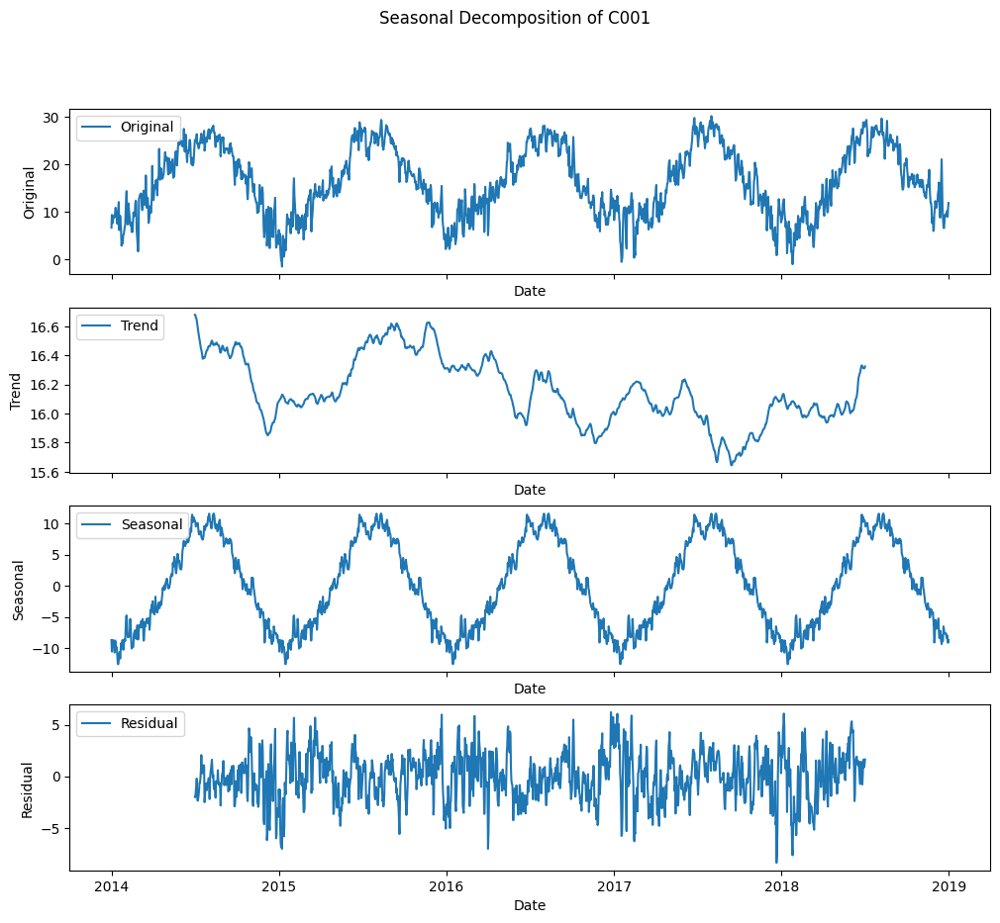

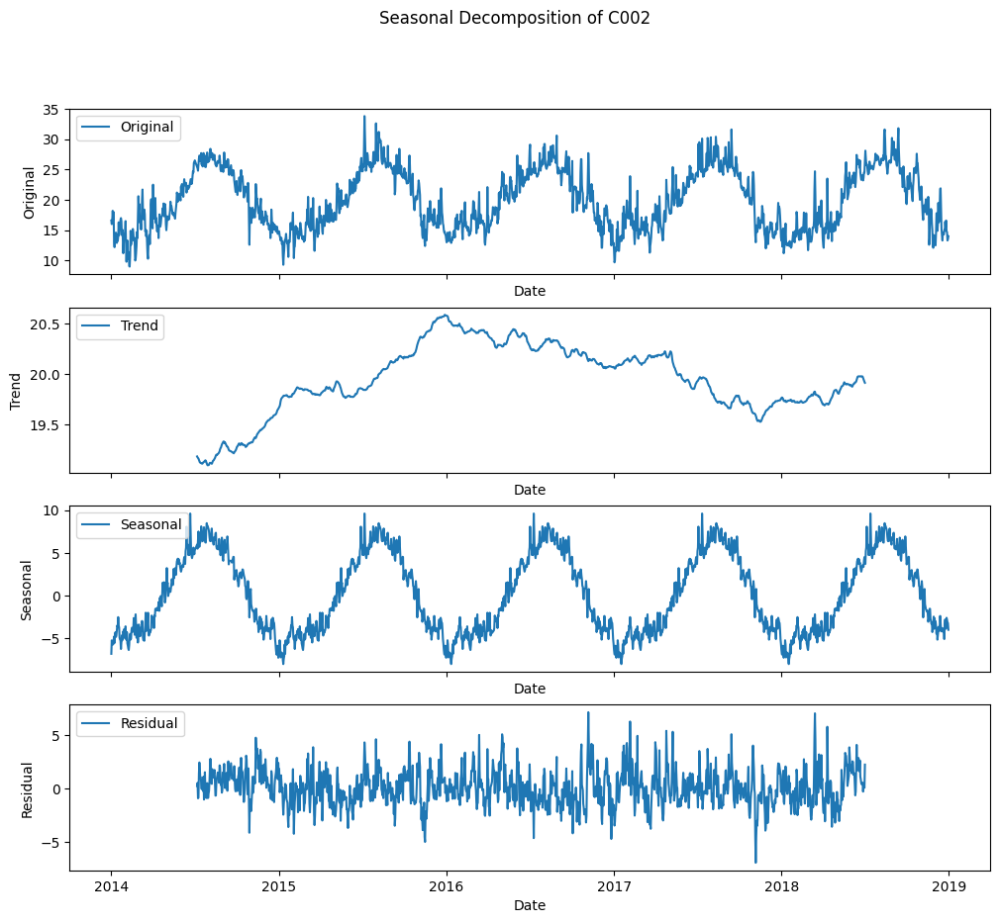

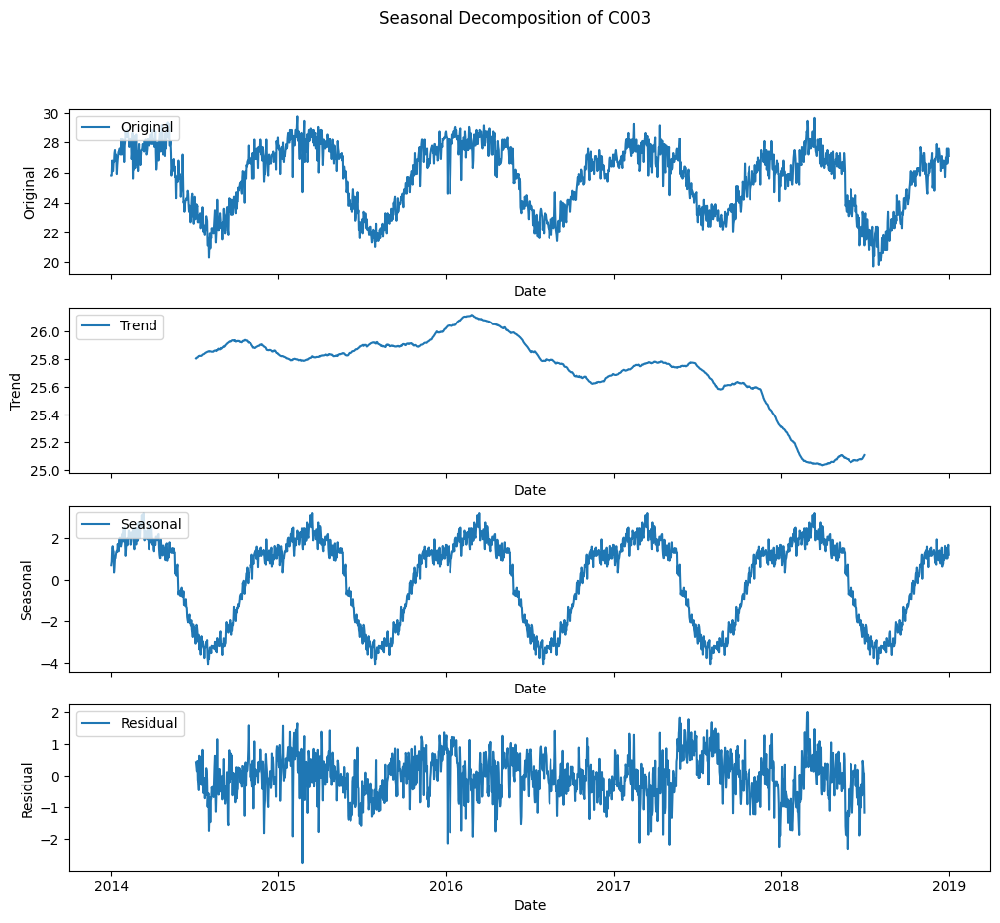

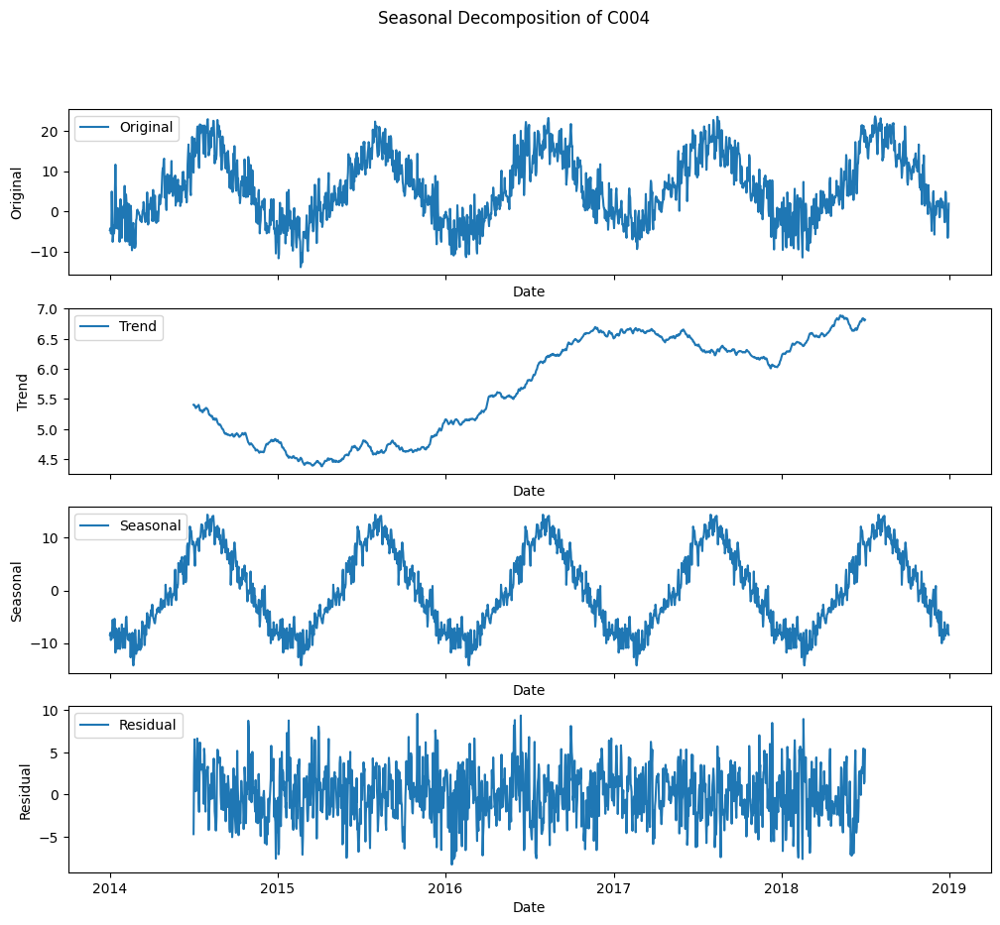

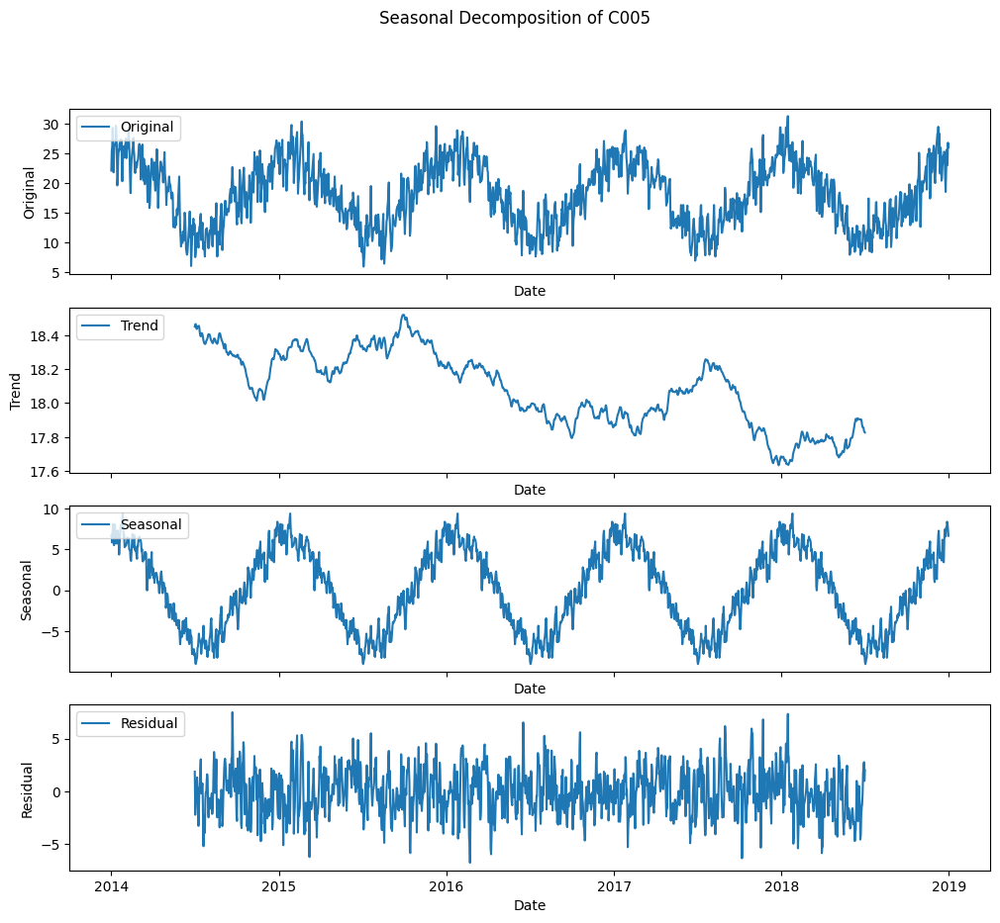

...

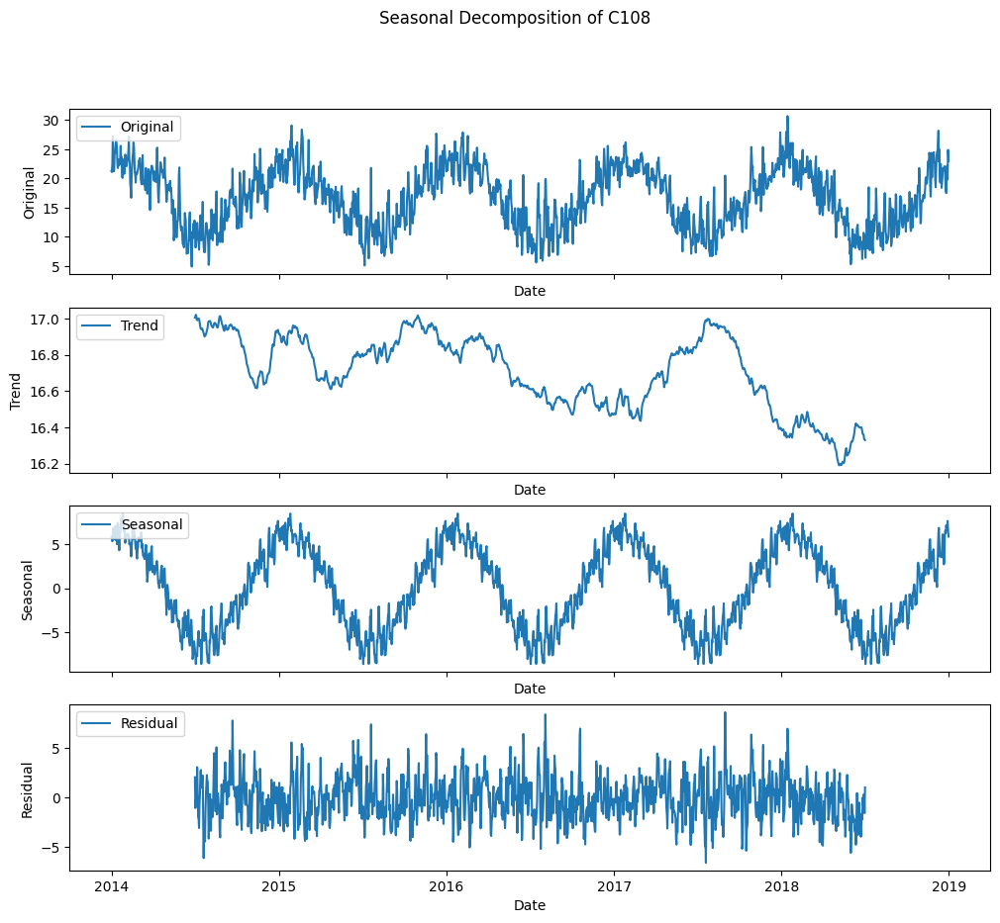

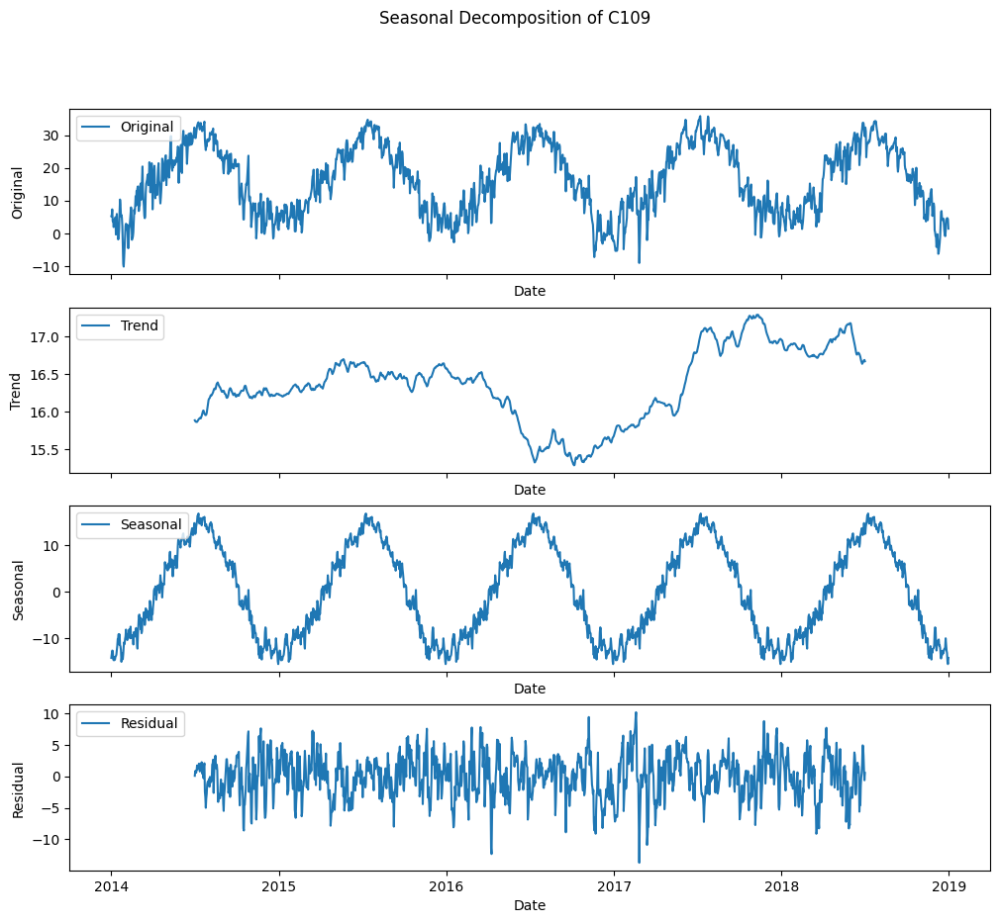

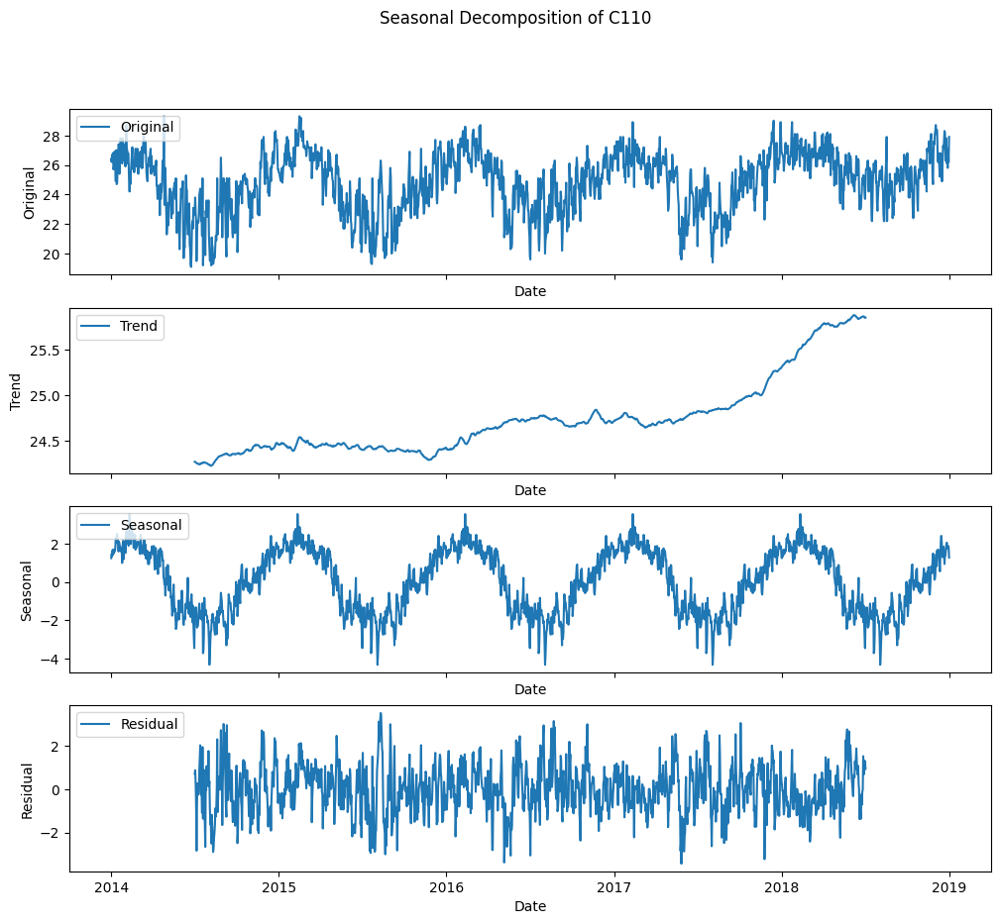

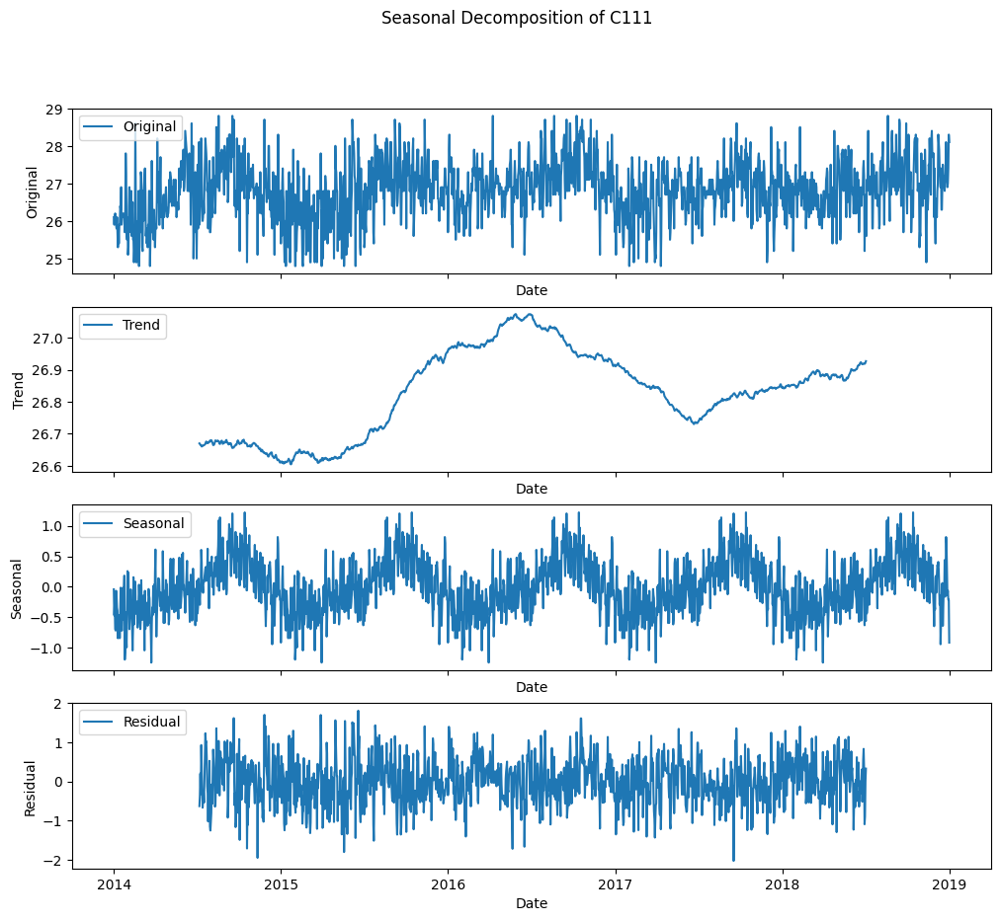

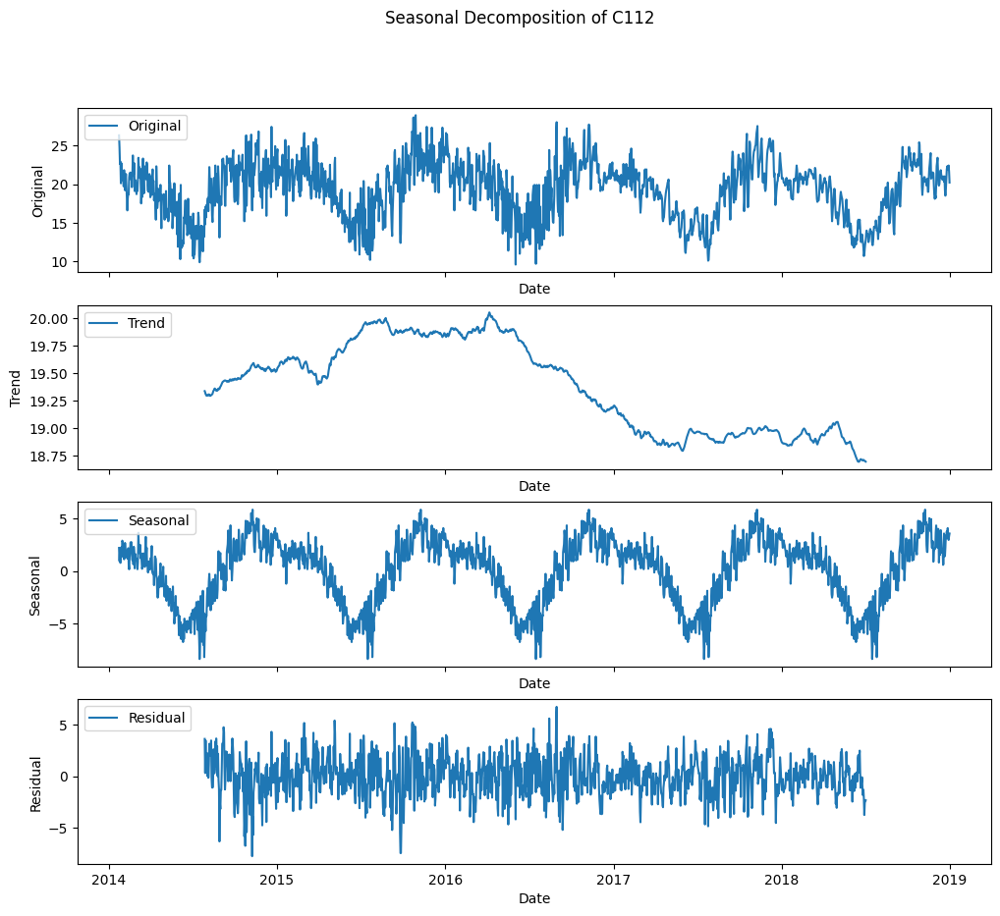

In [35]:
# Apply the decomposition for each city
city_ids = data['city_id'].unique()

for city_id in city_ids:
    city_data = data[data['city_id'] == city_id]
    seasonal_decomposition(city_data, city_id)

## Stationarity Test

In [36]:
# Function to perform ADF test
def adf_test(city_data, city_id):
    adftest = adfuller(city_data.dropna())
    print(f"ADF Test Results {city_id}, \n")
    print("Null Hypothesis: The series has a unit root (non-stationary)")
    print("ADF-Statistic:", adftest[0])
    print("P-Value:", adftest[1])
    print("Number of lags:", adftest[2])
    print("Number of observations:", adftest[3])
    print("Critical Values:", adftest[4])
    print("\n")
    if adftest[1] < 0.05:
        print("Conclusion: ")
        print("Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary ")
    else:
        print("Conclusion: ")
        print("Because P-value is greater than 0.05 , therefore the series is non_stationary ")
    print("\n")
    return adftest[1]  # Return p-value

In [37]:
# Function to fill NaN values with the first non-NaN value
def fill_na(series):
    first_valid = series.dropna().iloc[0]
    series = series.fillna(first_valid)
    return series

# Function to apply transformations to make the series stationary
def make_stationary(city_data, city_id):
    # Apply differencing
    city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
    city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data

    # Fill NaN values created by differencing
    city_data['diff_1'] = fill_na(city_data['diff_1'])
    city_data['diff_2'] = fill_na(city_data['diff_2'])

    # Check stationarity after differencing
    p_value_diff_1 = adf_test(city_data['diff_1'], f'{city_id} (First Difference)')
    if p_value_diff_1 > 0.05:
        p_value_diff_2 = adf_test(city_data['diff_2'], f'{city_id} (First + Seasonal Difference)')
        
        if p_value_diff_2 > 0.05:
            city_data['log'] = np.log(city_data['avg_temp_c'].replace(0, np.nan)).diff(1)
            city_data['log'] = fill_na(city_data['log'])
            p_value_log = adf_test(city_data['log'], f'{city_id} (Log + First Difference)')
            
            if p_value_log > 0.05:
                city_data['log_diff'] = city_data['log'].diff(12)  # Seasonal differencing for log data
                city_data['log_diff'] = fill_na(city_data['log_diff'])
                p_value_log_diff = adf_test(city_data['log_diff'], f'{city_id} (Log + First + Seasonal Difference)')
                return city_data['log_diff']
            else:
                return city_data['log']
        else:
            return city_data['diff_2']
    else:
        return city_data['diff_1']

In [38]:
# Apply ADF test and transformations for each city
city_ids = data['city_id'].unique()
non_stationary_cities = []
stationary_data = {}

for city_id in city_ids:
    city_data = data[data['city_id'] == city_id].copy()
    p_value = adf_test(city_data['avg_temp_c'], city_id)
    
    if p_value > 0.05:
        non_stationary_cities.append(city_id)
        stationary_series = make_stationary(data[data['city_id'] == city_id], city_id)
        # Update the original dataset with transformed values
        data.loc[data['city_id'] == city_id, 'avg_temp_c'] = stationary_series.round(2).values
        stationary_data[city_id] = stationary_series

# Display the non-stationary cities and their transformed data
print("Non-stationary cities and their transformed data:\n")
for city_id in non_stationary_cities:
    print(f"\nTransformed Data for {city_id}:\n")
    print(stationary_data[city_id].head(20))

ADF Test Results C001, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.4351064630962145
P-Value: 0.13207198472611453
Number of lags: 12
Number of observations: 1813
Critical Values: {'1%': np.float64(-3.433962014811523), '5%': np.float64(-2.86313550332995), '10%': np.float64(-2.5676193929209554)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C001 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -16.996297424073333
P-Value: 8.794554375127809e-30
Number of lags: 11
Number of observations: 1814
Critical Values: {'1%': np.float64(-3.4339600207952796), '5%': np.float64(-2.863134623063046), '10%': np.float64(-2.5676189242070433)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C002, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C002 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -17.130570111855118
P-Value: 7.15431908106218e-30
Number of lags: 11
Number of observations: 1791
Critical Values: {'1%': np.float64(-3.434006447337251), '5%': np.float64(-2.863155118104396), '10%': np.float64(-2.567629837184558)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C003, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.2572274524733373
P-Value: 0.18613409587146706
Number of lags: 9
Number of observations: 1813
Critical Values: {'1%': np.float64(-3.433962014811523), '5%': np.float64(-2.86313550332995), '10%': np.float64(-2.5676193929209554)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C003 (First Difference), 

Null Hypothesis: The series has a unit root (non-s

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C004, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.206272832219608
P-Value: 0.20397666334085834
Number of lags: 17
Number of observations: 1808
Critical Values: {'1%': np.float64(-3.433972018026501), '5%': np.float64(-2.8631399192826676), '10%': np.float64(-2.5676217442756872)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C004 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -14.870029646478866
P-Value: 1.668769438434168e-27
Number of lags: 16
Number of observations: 1809
Critical Values: {'1%': np.float64(-3.4339700129534423), '5%': np.float64(-2.8631390341376393), '10%': np.float64(-2.567621272963846)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C005, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C007 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -15.782972209949335
P-Value: 1.1254300568869638e-28
Number of lags: 16
Number of observations: 1808
Critical Values: {'1%': np.float64(-3.433972018026501), '5%': np.float64(-2.8631399192826676), '10%': np.float64(-2.5676217442756872)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C008, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.549989190295164
P-Value: 0.10378015479107738
Number of lags: 14
Number of observations: 1811
Critical Values: {'1%': np.float64(-3.433966009459769), '5%': np.float64(-2.8631372667825503), '10%': np.float64(-2.567620331903232)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 




C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C008 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -16.38479594186849
P-Value: 2.7296425425969425e-29
Number of lags: 13
Number of observations: 1812
Critical Values: {'1%': np.float64(-3.4339640110318004), '5%': np.float64(-2.8631363845692475), '10%': np.float64(-2.567619862152732)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C009, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -1.9309228512830396
P-Value: 0.317656735245167
Number of lags: 8
Number of observations: 1817
Critical Values: {'1%': np.float64(-3.4339540519343137), '5%': np.float64(-2.863131988080628), '10%': np.float64(-2.5676175211639354)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C009 (First Difference), 

Null Hypothesis: The series has a unit root (no

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C011 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -11.765847262526446
P-Value: 1.1195564934208908e-21
Number of lags: 20
Number of observations: 1805
Critical Values: {'1%': np.float64(-3.433978046594855), '5%': np.float64(-2.8631425806072164), '10%': np.float64(-2.567623161347749)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C012, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -3.1076080440491465
P-Value: 0.02599525844525524
Number of lags: 18
Number of observations: 1804
Critical Values: {'1%': np.float64(-3.4339800605797155), '5%': np.float64(-2.8631434696839992), '10%': np.float64(-2.5676236347535166)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C013, 

Null Hypothesis: The series h

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C014 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -15.276886603702916
P-Value: 4.634738835191726e-28
Number of lags: 14
Number of observations: 1811
Critical Values: {'1%': np.float64(-3.433966009459769), '5%': np.float64(-2.8631372667825503), '10%': np.float64(-2.567620331903232)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C015, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -3.2158866706938842
P-Value: 0.019083317182356885
Number of lags: 13
Number of observations: 1812
Critical Values: {'1%': np.float64(-3.4339640110318004), '5%': np.float64(-2.8631363845692475), '10%': np.float64(-2.567619862152732)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C016, 

Null Hypothesis: The series ha

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C022, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.016628268978128
P-Value: 0.27933011031044896
Number of lags: 8
Number of observations: 1817
Critical Values: {'1%': np.float64(-3.4339540519343137), '5%': np.float64(-2.863131988080628), '10%': np.float64(-2.5676175211639354)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C022 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -21.387974486776372
P-Value: 0.0
Number of lags: 7
Number of observations: 1818
Critical Values: {'1%': np.float64(-3.4339520666978056), '5%': np.float64(-2.8631311116872475), '10%': np.float64(-2.567617054512932)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 




C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C023, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.969333596187003
P-Value: 0.03785920482241558
Number of lags: 19
Number of observations: 1806
Critical Values: {'1%': np.float64(-3.433976034843506), '5%': np.float64(-2.8631416925158244), '10%': np.float64(-2.5676226884667694)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C024, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.537257935151552
P-Value: 0.10667018752866331
Number of lags: 15
Number of observations: 1810
Critical Values: {'1%': np.float64(-3.433968010099092), '5%': np.float64(-2.8631381499714745), '10%': np.float64(-2.567620802173316)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C024 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Sta

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C027, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.388615505728578
P-Value: 0.14497541296222072
Number of lags: 17
Number of observations: 1791
Critical Values: {'1%': np.float64(-3.434006447337251), '5%': np.float64(-2.863155118104396), '10%': np.float64(-2.567629837184558)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C027 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -14.511657048155298
P-Value: 5.711450028499649e-27
Number of lags: 16
Number of observations: 1792
Critical Values: {'1%': np.float64(-3.4340044039750235), '5%': np.float64(-2.863154216066867), '10%': np.float64(-2.5676293568762953)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C028, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-S

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C030, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -3.3793671966025127
P-Value: 0.011682677062828318
Number of lags: 15
Number of observations: 1810
Critical Values: {'1%': np.float64(-3.433968010099092), '5%': np.float64(-2.8631381499714745), '10%': np.float64(-2.567620802173316)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C031, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.957983600237737
P-Value: 0.03900889323936623
Number of lags: 12
Number of observations: 1813
Critical Values: {'1%': np.float64(-3.433962014811523), '5%': np.float64(-2.86313550332995), '10%': np.float64(-2.5676193929209554)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C033, 

Null Hypothesis: The series has a unit root (non-stati

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C034, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.886936800965585
P-Value: 0.04688829447604678
Number of lags: 18
Number of observations: 1807
Critical Values: {'1%': np.float64(-3.4339740253219566), '5%': np.float64(-2.863140805408186), '10%': np.float64(-2.5676222161097058)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C035, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.7494546191270675
P-Value: 0.06586439533800098
Number of lags: 17
Number of observations: 1808
Critical Values: {'1%': np.float64(-3.433972018026501), '5%': np.float64(-2.8631399192826676), '10%': np.float64(-2.5676217442756872)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C035 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-S

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C036 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -16.287596366782868
P-Value: 3.363329685807835e-29
Number of lags: 12
Number of observations: 1813
Critical Values: {'1%': np.float64(-3.433962014811523), '5%': np.float64(-2.86313550332995), '10%': np.float64(-2.5676193929209554)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C037, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.987482728564162
P-Value: 0.03608000653430532
Number of lags: 14
Number of observations: 1811
Critical Values: {'1%': np.float64(-3.433966009459769), '5%': np.float64(-2.8631372667825503), '10%': np.float64(-2.567620331903232)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C038, 

Null Hypothesis: The series has a 

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C039 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -16.958782974697606
P-Value: 9.342236998659334e-30
Number of lags: 11
Number of observations: 1814
Critical Values: {'1%': np.float64(-3.4339600207952796), '5%': np.float64(-2.863134623063046), '10%': np.float64(-2.5676189242070433)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C040, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -3.4028755180764314
P-Value: 0.01086123511580321
Number of lags: 22
Number of observations: 1789
Critical Values: {'1%': np.float64(-3.434010540924675), '5%': np.float64(-2.8631569252072455), '10%': np.float64(-2.5676307994135956)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C042, 

Null Hypothesis: The series ha

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C043 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -15.271795537114448
P-Value: 4.705972818001428e-28
Number of lags: 14
Number of observations: 1809
Critical Values: {'1%': np.float64(-3.4339700129534423), '5%': np.float64(-2.8631390341376393), '10%': np.float64(-2.567621272963846)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C044, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.3356106941499815
P-Value: 0.16073983507042938
Number of lags: 8
Number of observations: 1817
Critical Values: {'1%': np.float64(-3.4339540519343137), '5%': np.float64(-2.863131988080628), '10%': np.float64(-2.5676175211639354)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C044 (First Difference), 

Null Hypothesis: The series has a unit root (

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C048, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.780810661856157
P-Value: 0.06106754005965256
Number of lags: 6
Number of observations: 1819
Critical Values: {'1%': np.float64(-3.4339500836471712), '5%': np.float64(-2.8631302362582534), '10%': np.float64(-2.567616588375528)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C048 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -24.26348416045411
P-Value: 0.0
Number of lags: 5
Number of observations: 1820
Critical Values: {'1%': np.float64(-3.4339481027788024), '5%': np.float64(-2.8631293617920544), '10%': np.float64(-2.5676161227508754)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C049, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.25154

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C051, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -4.599812721445846
P-Value: 0.00012927234552734823
Number of lags: 16
Number of observations: 1809
Critical Values: {'1%': np.float64(-3.4339700129534423), '5%': np.float64(-2.8631390341376393), '10%': np.float64(-2.567621272963846)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C053, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -3.4145974814900164
P-Value: 0.010471196747938099
Number of lags: 20
Number of observations: 1805
Critical Values: {'1%': np.float64(-3.433978046594855), '5%': np.float64(-2.8631425806072164), '10%': np.float64(-2.567623161347749)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C054, 

Null Hypothesis: The series has a unit root (non-

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C055 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -13.949186737785826
P-Value: 4.7361496440861635e-26
Number of lags: 18
Number of observations: 1807
Critical Values: {'1%': np.float64(-3.4339740253219566), '5%': np.float64(-2.863140805408186), '10%': np.float64(-2.5676222161097058)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C056, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.416173391228804
P-Value: 0.13722352381341668
Number of lags: 12
Number of observations: 1776
Critical Values: {'1%': np.float64(-3.4340373743018104), '5%': np.float64(-2.8631687706662676), '10%': np.float64(-2.567637106781613)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C056 (First Difference), 

Null Hypothesis: The series has a unit root 

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C057 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -14.608120245560649
P-Value: 4.063697528567064e-27
Number of lags: 16
Number of observations: 1809
Critical Values: {'1%': np.float64(-3.4339700129534423), '5%': np.float64(-2.8631390341376393), '10%': np.float64(-2.567621272963846)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C058, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -3.515237350184774
P-Value: 0.007604282079872503
Number of lags: 19
Number of observations: 1806
Critical Values: {'1%': np.float64(-3.433976034843506), '5%': np.float64(-2.8631416925158244), '10%': np.float64(-2.5676226884667694)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C059, 

Null Hypothesis: The series ha

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C064, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.8888645319678243
P-Value: 0.046658308915179136
Number of lags: 7
Number of observations: 1815
Critical Values: {'1%': np.float64(-3.4339580289794225), '5%': np.float64(-2.8631337437669275), '10%': np.float64(-2.567618456010139)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C065, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.8899127491225984
P-Value: 0.04653364470925228
Number of lags: 12
Number of observations: 1813
Critical Values: {'1%': np.float64(-3.433962014811523), '5%': np.float64(-2.86313550332995), '10%': np.float64(-2.5676193929209554)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C066, 

Null Hypothesis: The series has a unit root (non-stat

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C068, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.617123978194952
P-Value: 0.08950948396971126
Number of lags: 21
Number of observations: 1804
Critical Values: {'1%': np.float64(-3.4339800605797155), '5%': np.float64(-2.8631434696839992), '10%': np.float64(-2.5676236347535166)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C068 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -8.10118558527773
P-Value: 1.2985392698384013e-12
Number of lags: 20
Number of observations: 1805
Critical Values: {'1%': np.float64(-3.433978046594855), '5%': np.float64(-2.8631425806072164), '10%': np.float64(-2.567623161347749)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C069, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C073 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -10.377923713379769
P-Value: 2.1769323784069937e-18
Number of lags: 24
Number of observations: 1801
Critical Values: {'1%': np.float64(-3.4339861159726306), '5%': np.float64(-2.863146142843122), '10%': np.float64(-2.5676250581282964)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C074, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.6826289466653903
P-Value: 0.07709275799532739
Number of lags: 19
Number of observations: 1797
Critical Values: {'1%': np.float64(-3.4339942213257535), '5%': np.float64(-2.8631497209507284), '10%': np.float64(-2.567626963361616)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C074 (First Difference), 

Null Hypothesis: The series has a unit root

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C077, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.859305727644567
P-Value: 0.05028896549206433
Number of lags: 14
Number of observations: 1810
Critical Values: {'1%': np.float64(-3.433968010099092), '5%': np.float64(-2.8631381499714745), '10%': np.float64(-2.567620802173316)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 




C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C077 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -15.843513520653612
P-Value: 9.630958625777329e-29
Number of lags: 13
Number of observations: 1811
Critical Values: {'1%': np.float64(-3.433966009459769), '5%': np.float64(-2.8631372667825503), '10%': np.float64(-2.567620331903232)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C078, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.029445626439383
P-Value: 0.27381328997888055
Number of lags: 8
Number of observations: 1817
Critical Values: {'1%': np.float64(-3.4339540519343137), '5%': np.float64(-2.863131988080628), '10%': np.float64(-2.5676175211639354)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 




C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C078 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -20.745078937971662
P-Value: 0.0
Number of lags: 7
Number of observations: 1818
Critical Values: {'1%': np.float64(-3.4339520666978056), '5%': np.float64(-2.8631311116872475), '10%': np.float64(-2.567617054512932)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C079, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.5009408631752548
P-Value: 0.1152455703920135
Number of lags: 13
Number of observations: 1812
Critical Values: {'1%': np.float64(-3.4339640110318004), '5%': np.float64(-2.8631363845692475), '10%': np.float64(-2.567619862152732)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C079 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C082, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.4048277196377215
P-Value: 0.14037845424962586
Number of lags: 12
Number of observations: 1813
Critical Values: {'1%': np.float64(-3.433962014811523), '5%': np.float64(-2.86313550332995), '10%': np.float64(-2.5676193929209554)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C082 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -18.53924178875582
P-Value: 2.0986177939698805e-30
Number of lags: 11
Number of observations: 1814
Critical Values: {'1%': np.float64(-3.4339600207952796), '5%': np.float64(-2.863134623063046), '10%': np.float64(-2.5676189242070433)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 




C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C083, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -6.026896109530659
P-Value: 1.4487144128454342e-07
Number of lags: 16
Number of observations: 1809
Critical Values: {'1%': np.float64(-3.4339700129534423), '5%': np.float64(-2.8631390341376393), '10%': np.float64(-2.567621272963846)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C084, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.728197010720254
P-Value: 0.06928475397210627
Number of lags: 6
Number of observations: 1819
Critical Values: {'1%': np.float64(-3.4339500836471712), '5%': np.float64(-2.8631302362582534), '10%': np.float64(-2.567616588375528)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C084 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C085 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -14.538069458481376
P-Value: 5.1997378665167874e-27
Number of lags: 13
Number of observations: 1812
Critical Values: {'1%': np.float64(-3.4339640110318004), '5%': np.float64(-2.8631363845692475), '10%': np.float64(-2.567619862152732)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C086, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.5408306616300367
P-Value: 0.10585313829362808
Number of lags: 14
Number of observations: 1811
Critical Values: {'1%': np.float64(-3.433966009459769), '5%': np.float64(-2.8631372667825503), '10%': np.float64(-2.567620331903232)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C086 (First Difference), 

Null Hypothesis: The series has a unit root 

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C087 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -16.474473460722905
P-Value: 2.2670877298272983e-29
Number of lags: 13
Number of observations: 1812
Critical Values: {'1%': np.float64(-3.4339640110318004), '5%': np.float64(-2.8631363845692475), '10%': np.float64(-2.567619862152732)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C088, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -3.4028755180764314
P-Value: 0.01086123511580321
Number of lags: 22
Number of observations: 1789
Critical Values: {'1%': np.float64(-3.434010540924675), '5%': np.float64(-2.8631569252072455), '10%': np.float64(-2.5676307994135956)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C089, 

Null Hypothesis: The series h

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C093, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.8576935690376413
P-Value: 0.05049348436955272
Number of lags: 25
Number of observations: 1800
Critical Values: {'1%': np.float64(-3.4339881389288407), '5%': np.float64(-2.863147035877915), '10%': np.float64(-2.567625533641975)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 


ADF Test Results C093 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -8.003270248085313
P-Value: 2.3033805283977043e-12
Number of lags: 24
Number of observations: 1801
Critical Values: {'1%': np.float64(-3.4339861159726306), '5%': np.float64(-2.863146142843122), '10%': np.float64(-2.5676250581282964)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C094, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C095, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -5.226646948987773
P-Value: 7.755024861366654e-06
Number of lags: 13
Number of observations: 1806
Critical Values: {'1%': np.float64(-3.433976034843506), '5%': np.float64(-2.8631416925158244), '10%': np.float64(-2.5676226884667694)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C096, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -3.363617289462037
P-Value: 0.012263477864693255
Number of lags: 16
Number of observations: 1809
Critical Values: {'1%': np.float64(-3.4339700129534423), '5%': np.float64(-2.8631390341376393), '10%': np.float64(-2.567621272963846)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C097, 

Null Hypothesis: The series has a unit root (non-s

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C097 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -9.965765897825577
P-Value: 2.3093535355902663e-17
Number of lags: 22
Number of observations: 1803
Critical Values: {'1%': np.float64(-3.4339820768018106), '5%': np.float64(-2.8631443597478143), '10%': np.float64(-2.567624108684946)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C098, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.046581054085033
P-Value: 0.26652952790752715
Number of lags: 14
Number of observations: 1808
Critical Values: {'1%': np.float64(-3.433972018026501), '5%': np.float64(-2.8631399192826676), '10%': np.float64(-2.5676217442756872)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 




C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C098 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -15.508707307670814
P-Value: 2.3638818701230703e-28
Number of lags: 13
Number of observations: 1809
Critical Values: {'1%': np.float64(-3.4339700129534423), '5%': np.float64(-2.8631390341376393), '10%': np.float64(-2.567621272963846)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C099, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.1707076758630497
P-Value: 0.2170480953336667
Number of lags: 14
Number of observations: 1811
Critical Values: {'1%': np.float64(-3.433966009459769), '5%': np.float64(-2.8631372667825503), '10%': np.float64(-2.567620331903232)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 




C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C099 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -15.381493697175836
P-Value: 3.402826042163357e-28
Number of lags: 13
Number of observations: 1812
Critical Values: {'1%': np.float64(-3.4339640110318004), '5%': np.float64(-2.8631363845692475), '10%': np.float64(-2.567619862152732)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C100, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -3.6308151863469216
P-Value: 0.005198510716778123
Number of lags: 13
Number of observations: 1806
Critical Values: {'1%': np.float64(-3.433976034843506), '5%': np.float64(-2.8631416925158244), '10%': np.float64(-2.5676226884667694)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C101, 

Null Hypothesis: The series h

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C103 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -15.916421403121623
P-Value: 8.014863164029572e-29
Number of lags: 14
Number of observations: 1811
Critical Values: {'1%': np.float64(-3.433966009459769), '5%': np.float64(-2.8631372667825503), '10%': np.float64(-2.567620331903232)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C104, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -9.12258055571025
P-Value: 3.1758330013977058e-15
Number of lags: 9
Number of observations: 1814
Critical Values: {'1%': np.float64(-3.4339600207952796), '5%': np.float64(-2.863134623063046), '10%': np.float64(-2.5676189242070433)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C105, 

Null Hypothesis: The series has

C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C105 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -16.15470243680818
P-Value: 4.530940661358777e-29
Number of lags: 13
Number of observations: 1811
Critical Values: {'1%': np.float64(-3.433966009459769), '5%': np.float64(-2.8631372667825503), '10%': np.float64(-2.567620331903232)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C106, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.3248854178103375
P-Value: 0.16406748435298024
Number of lags: 19
Number of observations: 1806
Critical Values: {'1%': np.float64(-3.433976034843506), '5%': np.float64(-2.8631416925158244), '10%': np.float64(-2.5676226884667694)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 




C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C106 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -8.008297392554004
P-Value: 2.236655573368094e-12
Number of lags: 25
Number of observations: 1800
Critical Values: {'1%': np.float64(-3.4339881389288407), '5%': np.float64(-2.863147035877915), '10%': np.float64(-2.567625533641975)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C107, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.4366537845290437
P-Value: 0.13165720386419216
Number of lags: 22
Number of observations: 1803
Critical Values: {'1%': np.float64(-3.4339820768018106), '5%': np.float64(-2.8631443597478143), '10%': np.float64(-2.567624108684946)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 




C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C107 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -13.764349630989473
P-Value: 9.948998419224935e-26
Number of lags: 21
Number of observations: 1804
Critical Values: {'1%': np.float64(-3.4339800605797155), '5%': np.float64(-2.8631434696839992), '10%': np.float64(-2.5676236347535166)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C108, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.701407658086348
P-Value: 0.07379499931103904
Number of lags: 15
Number of observations: 1810
Critical Values: {'1%': np.float64(-3.433968010099092), '5%': np.float64(-2.8631381499714745), '10%': np.float64(-2.567620802173316)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 




C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C108 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -16.805349279485963
P-Value: 1.2110223344032868e-29
Number of lags: 14
Number of observations: 1811
Critical Values: {'1%': np.float64(-3.433966009459769), '5%': np.float64(-2.8631372667825503), '10%': np.float64(-2.567620331903232)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C109, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -2.4166353837938566
P-Value: 0.1370961361640085
Number of lags: 24
Number of observations: 1801
Critical Values: {'1%': np.float64(-3.4339861159726306), '5%': np.float64(-2.863146142843122), '10%': np.float64(-2.5676250581282964)}


Conclusion: 
Because P-value is greater than 0.05 , therefore the series is non_stationary 




C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_1'] = city_data['avg_temp_c'].diff(1)
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['diff_2'] = city_data['diff_1'].diff(12)  # Seasonal differencing for monthly data
C:\Users\Pehansi Karunaratne\AppData\Local\Temp\ipykernel_20124\4035857014.py:14: SettingWithCopyWarning: 
A 

ADF Test Results C109 (First Difference), 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -9.569946528419262
P-Value: 2.302595999281422e-16
Number of lags: 23
Number of observations: 1802
Critical Values: {'1%': np.float64(-3.4339840952648695), '5%': np.float64(-2.8631452508003057), '10%': np.float64(-2.567624583142913)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C110, 

Null Hypothesis: The series has a unit root (non-stationary)
ADF-Statistic: -4.183456882024387
P-Value: 0.000702698429829333
Number of lags: 11
Number of observations: 1813
Critical Values: {'1%': np.float64(-3.433962014811523), '5%': np.float64(-2.86313550332995), '10%': np.float64(-2.5676193929209554)}


Conclusion: 
Because P-value is less than 0.05 we can reject the null hypothesis and conclude that the series is stationary 


ADF Test Results C111, 

Null Hypothesis: The series has a

In [39]:
results = []

# Apply the ADF test for each city and store the results in the list
city_ids = data['city_id'].unique()

for city_id in city_ids:
    city_data = data[data['city_id'] == city_id]
    adftest = adfuller(city_data['avg_temp_c'])
    stationary = adftest[1] < 0.05
    results.append({
        'City': city_id, 
        'ADF-Statistic': adftest[0], 
        'P-Value': adftest[1], 
        'Number of Lags': adftest[2], 
        'Number of Observations': adftest[3], 
        'Critical Values': adftest[4], 
        'Stationary': stationary
    })

# Convert the list of dictionaries to a DataFrame
adf_results = pd.DataFrame(results)

adf_results["Stationary"].value_counts()

Stationary
True    100
Name: count, dtype: int64

In [40]:
# Save the updated dataset to a CSV file
data.reset_index(inplace=True)
data.to_csv(r'../data/part_1/stationary_weather_data.csv', index=False)